<a href="https://colab.research.google.com/github/Eshaa2001/GIS/blob/main/ps3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Uncovering Philadelphia’s Socioeconomic Landscape

Philadelphia is a city of vibrant neighborhoods, each with unique characteristics and challenges. This analysis dives deep into the city’s socioeconomic landscape to understand which neighborhoods are thriving, which are underdeveloped, and where there may be opportunities for growth.

Installing the necessary dependencies

In [ ]:
!pip install geopandas==1.0.1
!pip install mapclassify
!pip install openpyxl
!pip install folium
!pip install contextily
!pip install holoviews geoviews bokeh cartopy
!pip install datashader
!pip install jupyter_bokeh

Importing the necessary libraries

In [ ]:
import os, zipfile #basics
import pandas as pd #data management
import matplotlib.pyplot as plt #vis

import mapclassify #need for thematic map classification
import geopandas as gpd #gis/maps

#will display all output not just last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from google.colab import files #to download from colab onto hd

from google.colab import data_table
data_table.enable_dataframe_formatter() #this enables spreadsheet view upon calling dataframe (without() )
from shapely.geometry import Point
import seaborn as sns
import contextily as ctx
import numpy as np

import matplotlib.patches as mpatches
import plotly.graph_objects as go
import plotly.express as px
import folium

Shapefile - Philadelphia County!!

In [ ]:

#i found one and reposted on my website, download it onto colab:
! wget -q -O Philly.zip https://www2.census.gov/geo/tiger/TIGER2023/FACES/tl_2023_42101_faces.zip

zip_ref = zipfile.ZipFile('Philly.zip', 'r'); zip_ref.extractall(); zip_ref.close() #just unzipping
Philly_shp=gpd.read_file('tl_2023_42101_faces.shp') #load the shapefile with gpd as njC
Philly_shp.columns

Index(['TFID', 'STATEFP20', 'COUNTYFP20', 'TRACTCE20', 'BLKGRPCE20',
       'BLOCKCE20', 'SUFFIX1CE', 'ZCTA5CE20', 'UACE20', 'PUMACE20', 'STATEFP',
       'COUNTYFP', 'TRACTCE', 'BLKGRPCE', 'COUSUBFP', 'SUBMCDFP', 'ESTATEFP',
       'CONCTYFP', 'PLACEFP', 'AIANNHFP', 'AIANNHCE', 'COMPTYP', 'TRSUBFP',
       'TRSUBCE', 'ANRCFP', 'TTRACTCE', 'TBLKGPCE', 'ELSDLEA', 'SCSDLEA',
       'UNSDLEA', 'SDADMLEA', 'CD118FP', 'SLDUST', 'SLDLST', 'CSAFP', 'CBSAFP',
       'METDIVFP', 'LWFLAG', 'OFFSET', 'ATOTAL', 'INTPTLAT', 'INTPTLON',
       'geometry'],
      dtype='object')

In [ ]:
import pandas as pd
df_Neighbor = pd.read_excel('https://www.fourfront.us/wp-content/uploads/2024/06/Philadelphia-Neighborhoods-and-Zip-Codes-Updated_2024-05-17.xlsx',sheet_name='PIVOT-TABLE DATA')
df_BCam = pd.read_csv('https://opendata.arcgis.com/api/v3/datasets/f0ac679b40384a158f675fa107fb4cfd_0/downloads/data?format=csv&spatialRefId=4326&where=1%3D1')
df_Neighbor.head()

,Neighborhood,Primary Zips,Secondary Zips (If applicable),Neighboring Neighborhoods,Nearby Neighborhoods,USPS Locale Designation
0,Academy Gardens,19114,19136,"Aston Woodbridge, Morrell Park, Northeast Airp...","Crestmont Farms, Franklin Mills, Holmesburg, L...",Torresdale
1,Allegheny West,19132,19129,"East Falls, East Park, Glenwood, Strawberry Ma...","Brewerytown, East Falls, Franklinville, German...",North Philadelphia
2,Andorra,19128,19444,"Upper Roxborough, Wissahickon Park","Cedarbrook, Chestnut Hill, Dearnley Park, Germ...",Roxborough
3,Angora,19143,NaN,"Cobbs Creek, Squirrel Hill, Kingseeing, Cedar ...",NaN,Kingsessing
4,Ashton Woodenbridge,19114,19136,"Academy Gardens, Northeast Airport, Pennypack,...","Bustleton, Crestmont Farms, Holmesburg, Lexing...",Torresdale


Merging the datasets based on "zipcodes"

In [ ]:
Philly_shp['ZCTA5CE20'] = Philly_shp['ZCTA5CE20'].astype(str)
df_BCam['in_zip'] = df_BCam['in_zip'].astype(str)
df_Neighbor['Primary Zips'] = df_Neighbor['Primary Zips'].astype(str)

phC1 = pd.merge(Philly_shp, df_BCam, left_on='ZCTA5CE20',right_on='in_zip',how='inner',indicator=True)
phC1 = pd.merge(phC1, df_Neighbor,left_on='ZCTA5CE20',right_on='Primary Zips',how='inner',indicator='merge_philly_neighbor')
df_BCam.head()

,X,Y,objectid,in_zip,user_business_name,user_address,user_city,user_state,user_project_cost,user_award_approval_date,user_award_amount,user_fund_type,user_council_district_number,user_commercial_corridor
0,-75.123850,40.021769,1,19120,Restaurant & Pupuseria Emily (FoodTruck),111 W. Wyoming Ave.,Philadelphia,PA,4695.00,2024/03/18 00:00:00+00,2347.50,CSP,7,Rising Sun and Wyoming
1,-75.084787,40.016317,2,19124,Thiouna’s Professional African Hair Braiding,4660 Frankford Avenue,Philadelphia,PA,2390.99,2024/03/08 00:00:00+00,2309.99,NPI 100%,7,I do not know
2,-75.225297,39.956703,3,19139,2nd Threadz LLC,205 S. 52nd Street,Philadelphia,PA,2390.99,2024/02/27 00:00:00+00,2390.99,NPI 100%,3,52nd Street
3,-75.225026,39.965774,4,19139,Abc University,318 N. 52nd Street,Philadelphia,PA,3000.99,2024/02/27 00:00:00+00,3000.99,NPI 75%,3,52nd and Haverford
4,-75.226715,39.949853,5,19143,Johnson Family Financial Services,623 South 52nd Street,Philadelphia,PA,3000.99,2024/02/27 00:00:00+00,3000.99,NPI 100%,3,52nd and Cedar


In [ ]:
phC1=phC1[['Neighborhood','X','Y','ZCTA5CE20','geometry']]
phC1.head()

,Neighborhood,X,Y,ZCTA5CE20,geometry
0,Clearview,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877..."
1,Eastwick,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877..."
2,Penrose,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877..."
3,Clearview,-75.226723,39.903215,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877..."
4,Eastwick,-75.226723,39.903215,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877..."


Plotting Business Cameras across Philadelphia

<Axes: >

<Axes: >

Text(0.5, 1.0, 'Cameras in Philadelphia')

[]

[]

<ipython-input-7-1b15d90e0a24>:20: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  legend = ax.legend(title="Legend", title_fontsize='13', fontsize='11', loc='upper right', frameon=True)


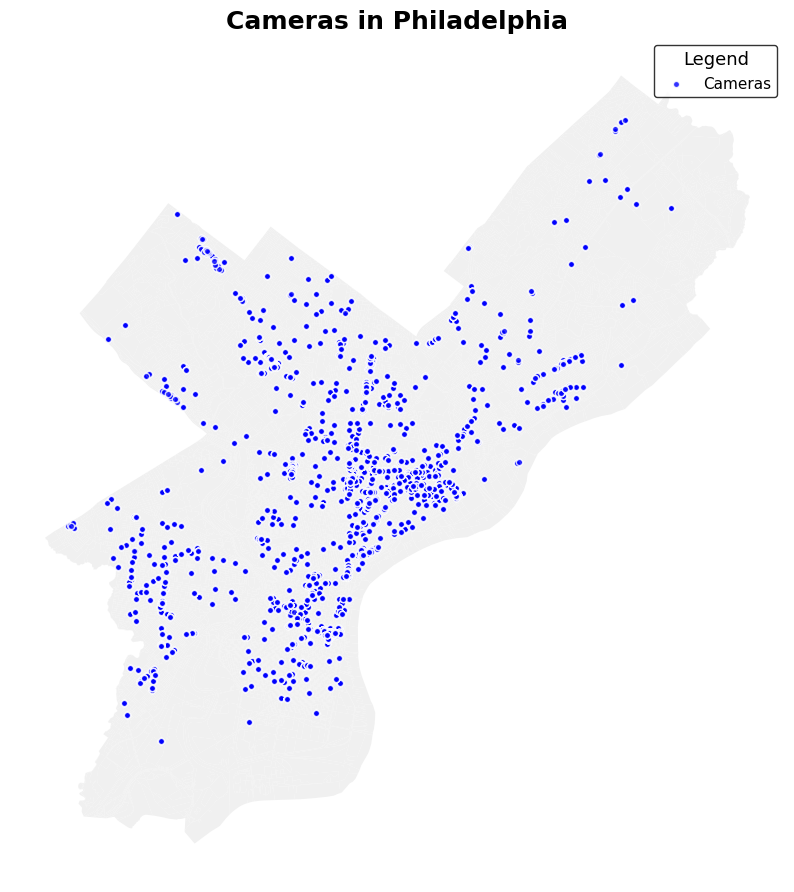

In [ ]:
# Step 1: Convert camera locations to GeoDataFrame
geometry = [Point(xy) for xy in zip(phC1['X'], phC1['Y'])]
camera_gdf = gpd.GeoDataFrame(phC1, crs="EPSG:4326", geometry=geometry)

# Step 2: Create a figure and axis to plot
fig, ax = plt.subplots(1, figsize=(10, 12))

# Step 3: Plot the Philly base shapefile as the background with improved styling
Philly_shp.plot(ax=ax, color='#f0f0f0', edgecolor='#B5C0D0', linewidth=0, label="Philadelphia Base Map")

# Step 4: Plot the cameras as a scatter plot with improved marker styling
camera_gdf.plot(ax=ax, color='blue', markersize=15, marker='o', label="Cameras", alpha=0.8, edgecolor='white')

# Step 5: Customize the title, font sizes, and overall plot aesthetics
ax.set_title("Cameras in Philadelphia", fontsize=18, fontweight='bold')
ax.set_xticks([])  # Remove x-axis ticks
ax.set_yticks([])  # Remove y-axis ticks

# Step 6: Add a legend, increase its size and position it properly
legend = ax.legend(title="Legend", title_fontsize='13', fontsize='11', loc='upper right', frameon=True)
legend.get_frame().set_edgecolor('black')
legend.get_frame().set_linewidth(1)

# Step 7: Add a neat border around the map
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)

# Show the final refined plot
plt.show()


Let's take a look how the neighborhood in Philadelphia look like!

(-75.280266, -74.955763)

(39.867004, 40.137992)

<Axes: >

[]

[]

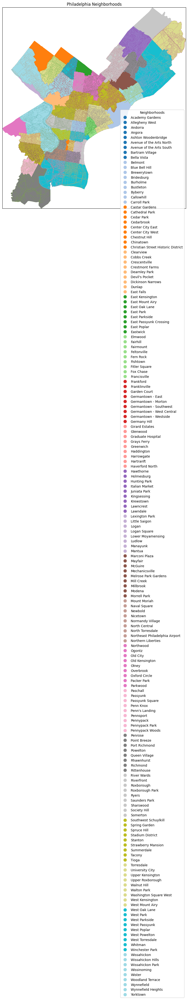

In [ ]:
# Set plot bounds to cover the entire area
fig, ax = plt.subplots(1, figsize=(10, 12))  # Increase the size to cover more area
ax.set_xlim(phC1.total_bounds[0], phC1.total_bounds[2])  # xmin, xmax
ax.set_ylim(phC1.total_bounds[1], phC1.total_bounds[3])  # ymin, ymax

# Plot the neighborhoods
phC1.plot(ax=ax, column='Neighborhood', legend=True, cmap='tab20',
          edgecolor='grey', linewidth=0)

# Customize the legend and move it outside the plot
legend = ax.get_legend()
legend.set_bbox_to_anchor((1, 0.5))
legend.set_title("Neighborhoods")

# Customize title and remove ticks
ax.title.set_text("Philadelphia Neighborhoods")
ax.set_xticks([])  # Remove x-axis ticks
ax.set_yticks([])  # Remove y-axis ticks

# Show the plot
plt.show()


Plotting Business Cameras across various neighborhoods of Philadelphia

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 1.0, 'Philadelphia Neighborhoods and Cameras')

[]

[]

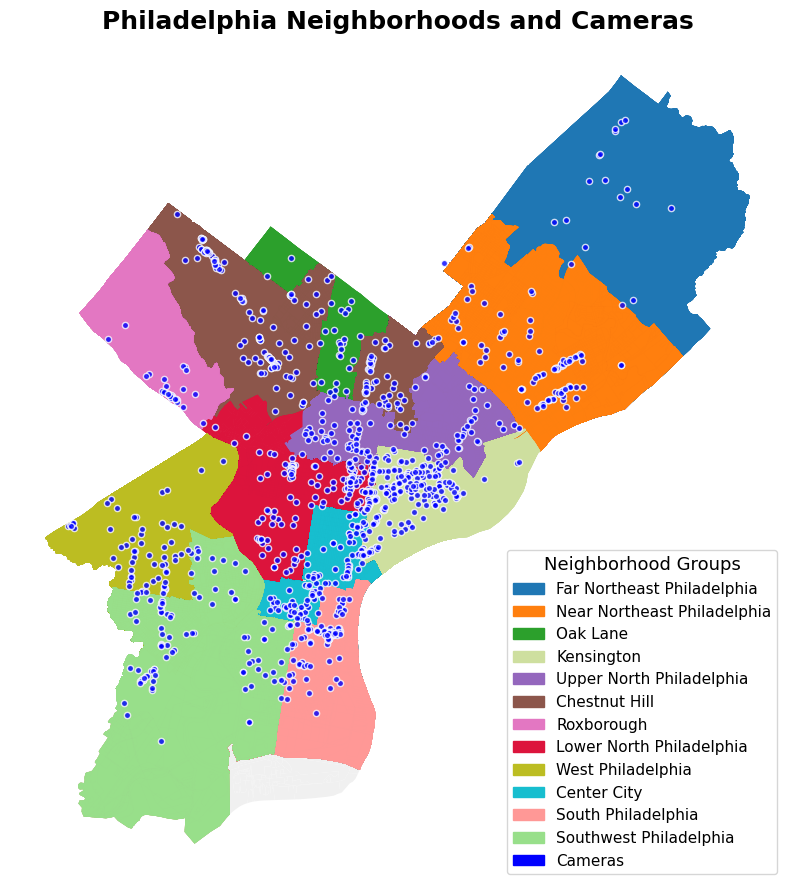

In [ ]:
import matplotlib.patches as mpatches
# Step 1: Convert camera locations to GeoDataFrame
geometry = [Point(xy) for xy in zip(df_BCam['X'], df_BCam['Y'])]
camera_gdf = gpd.GeoDataFrame(df_BCam, crs="EPSG:4326", geometry=geometry)

# Step 2: Define neighborhood groups and their respective colors
neighborhood_groups = {
    'Far Northeast Philadelphia': [
        'Academy Gardens', 'Bustleton', 'Byberry', 'Crestmont Farms', 'Morrell Park', 'Parkwood',
        'Somerton', 'Torresdale', 'Ashton Woodenbridge', 'Burholme',
        'Crescentville', 'Krewstown', 'Lawndale', 'Millbrook',
        'Modena', 'Normandy Village', 'North Torresdale', 'Northeast Philadelphia Airport',
        'Northwood', 'Oxford Circle', 'Pennypack Park', 'Pennypack Woods', 'Ryers',
        'Stanton', 'Walton Park', 'West Torresdale', 'Winchester Park','Mechanicsville'
    ],
    'Near Northeast Philadelphia': [
        'Castor Gardens', 'Fox Chase', 'Holmesburg', 'Mayfair', 'Rhawnhurst', 'Tacony',
        'Frankford', 'Wissinoming', 'Lawncrest', 'McGuire', 'Summerdale',
        'Lexington Park'
    ],
    'Oak Lane': [
        'East Oak Lane', 'West Oak Lane', 'Fern Rock', 'Ogontz', 'Logan', 'Cedarbrook'
    ],
    'Kensington': [
        'Kensington', 'East Kensington', 'West Kensington', 'Upper Kensington', 'Harrowgate',
        'Fishtown', 'Old Kensington', 'Port Richmond', 'Richmond', 'River Wards','Bridesburg'
    ],
    'Upper North Philadelphia': [
        'Allegheny West', 'Fairhill', 'Hunting Park', 'Nicetown', 'Tioga', 'Juniata Park',
        'Feltonville'
    ],
    'Chestnut Hill': [
        'Chestnut Hill', 'Blue Bell Hill', 'East Mount Airy', 'Germantown - East',
        'Germantown - Morton', 'Germantown - Southwest', 'Germantown - West Central',
        'Germantown - Westside', 'Olney', 'Penn Knox', 'West Mount Airy', 'Wissahickon Park', 'Wister'
    ],
    'Roxborough': [
        'Andorra', 'Manayunk', 'Wissahickon', 'Roxborough', 'Upper Roxborough', 'Dearnley Park',
        'Germany Hill', 'Roxborough Park', 'Wissahickon Hills'
    ],
    'Lower North Philadelphia': [
        'North Central', 'Brewerytown', 'Sharswood', 'Strawberry Mansion', 'Glenwood', 'Ludlow',
        'East Falls', 'East Poplar', 'Fairmount', 'Francisville', 'Spring Garden', 'Hartranft'
    ],
    'West Philadelphia': [
        'Belmont', 'Cobbs Creek', 'Dunlap', 'East Parkside', 'Haddington', 'Mantua', 'Mill Creek',
        'Overbrook', 'Powelton', 'Saunders Park', 'Spruce Hill', 'Walnut Hill', 'University City',
        'Wynnefield', 'West Parkside', 'West Poplar', 'West Powelton', 'Kingsessing', 'Carroll Park',
        'Cathedral Park', 'Cedar Park', 'Garden Court', 'Haverford North', 'West Park',
        'Wynnefield Heights'
    ],
    'Center City': [
        'Avenue of the Arts North', 'Avenue of the Arts South', 'Center City', 'Center City East',
        'Center City West', 'Chinatown', 'Logan Square', 'Old City', 'Rittenhouse',
        'Society Hill', 'Washington Square West', 'Callowhill', 'Christian Street Historic District',
        'Fitler Square', 'Graduate Hospital', 'Greenwich', 'Northern Liberties',
        'Yorktown'
    ],
    'South Philadelphia': [
        'Bella Vista', 'Dickinson Narrows', 'East Passyunk Crossing', 'Girard Estates',
        'Lower Moyamensing', 'Marconi Plaza', 'Newbold', 'Passyunk Square', 'Pennsport',
        'Point Breeze', 'Queen Village', 'Stadium District', 'Whitman', 'Hawthorne',
        'Italian Market', 'Little Saigon', 'Packer Park', 'Passyunk', 'Penrose', 'Riverfront',
        'West Passyunk'
    ],
    'Southwest Philadelphia': [
        'Bartram Village', 'Elmwood', 'Grays Ferry', 'Paschall', 'Southwest Schuylkill',
        'Kingsessing', 'Angora', 'Clearview', 'Devil\'s Pocket', 'Eastwick', 'Mount Moriah',
        'Naval Square', 'Woodland Terrace'
    ]
}

region_colors = {
    'Far Northeast Philadelphia': '#1f77b4',
    'Near Northeast Philadelphia': '#ff7f0e',
    'Oak Lane': '#2ca02c',
    'Kensington': '#CEDF9F',
    'Upper North Philadelphia': '#9467bd',
    'Chestnut Hill': '#8c564b',
    'Roxborough': '#e377c2',
    'Lower North Philadelphia': '#dc143c',
    'West Philadelphia': '#bcbd22',
    'Center City': '#17becf',
    'South Philadelphia': '#ff9896',
    'Southwest Philadelphia': '#98df8a'
}


# Create a new column 'Region' based on the neighborhood groupings
phC1['Region'] = phC1['Neighborhood'].apply(lambda x: next((key for key, value in neighborhood_groups.items() if x in value), 'Other'))

# Step 3: Create a figure and axis to plot
fig, ax = plt.subplots(1, figsize=(10, 12))

# Step 4: Plot the Philly base shapefile as the background
Philly_shp.plot(ax=ax, color='#f0f0f0', edgecolor='#B5C0D0', linewidth=0)

# Plot each region with its corresponding color
for region, color in region_colors.items():
    phC1[phC1['Region'] == region].plot(ax=ax, color=color, edgecolor='grey', linewidth=0)

# Step 6: Plot the cameras as a scatter plot
camera_gdf.plot(ax=ax, color='blue', markersize=15, marker='o', alpha=0.8, edgecolor='white')

# Step 7: Add a custom legend for neighborhood groups (regions)
patches = [mpatches.Patch(color=color, label=region) for region, color in region_colors.items()]
camera_patch = mpatches.Patch(color='blue', label='Cameras')  # Add legend for cameras
patches.append(camera_patch)
ax.legend(handles=patches, title="Neighborhood Groups", title_fontsize='13', fontsize='11', loc='lower right', frameon=True)

# Step 8: Customize the title and remove ticks
ax.set_title("Philadelphia Neighborhoods and Cameras", fontsize=18, fontweight='bold')
ax.set_xticks([])  # Remove x-axis ticks
ax.set_yticks([])  # Remove y-axis ticks

# Add a neat border around the map
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)

# Show the final refined plot
plt.show()

Let's take the crime rates into consideration, but why is it important?
It serves as a key indicator of neighborhood safety and stability.

Here’s how the crime data contributed to the overall socioeconomic analysis and neighborhood classification.

In [ ]:
df_crime = pd.read_csv('https://phl.carto.com/api/v2/sql?filename=incidents_part1_part2&format=csv&q=SELECT%20*%20,%20ST_Y(the_geom)%20AS%20lat,%20ST_X(the_geom)%20AS%20lng%20FROM%20incidents_part1_part2%20WHERE%20dispatch_date_time%20%3E=%20%272023-01-01%27%20AND%20dispatch_date_time%20%3C%20%272024-01-01%27')
df_crime.columns

Index(['the_geom', 'cartodb_id', 'the_geom_webmercator', 'objectid', 'dc_dist',
       'psa', 'dispatch_date_time', 'dispatch_date', 'dispatch_time', 'hour',
       'dc_key', 'location_block', 'ucr_general', 'text_general_code',
       'point_x', 'point_y', 'lat', 'lng'],
      dtype='object')

<Axes: >

<Axes: >

Text(0.5, 1.0, 'Crime Incidents in Philadelphia')

[]

[]

<ipython-input-8-14cf79d838ae>:17: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


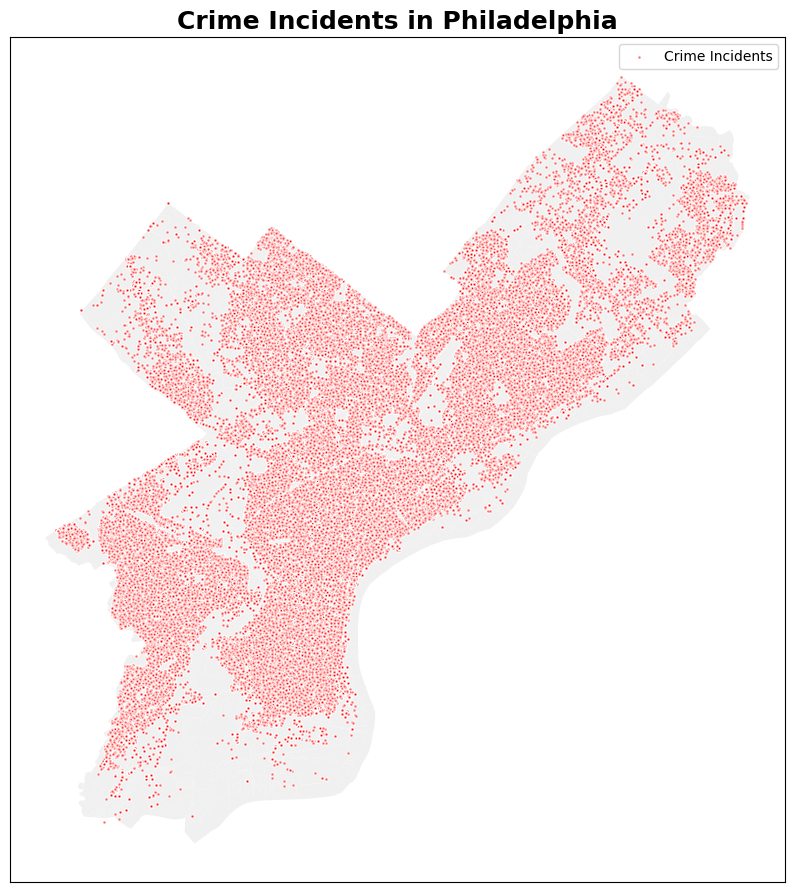

In [ ]:
geometry = [Point(xy) for xy in zip(df_crime['lng'], df_crime['lat'])]
crime_gdf = gpd.GeoDataFrame(df_crime, crs="EPSG:4326", geometry=geometry)

# Step 2: Create a figure and axis to plot
fig, ax = plt.subplots(1, figsize=(10, 12))

# Step 3: Plot the base map (Philly neighborhoods, for example)
Philly_shp.plot(ax=ax, color='#f0f0f0', edgecolor='#B5C0D0', linewidth=0, label="Philadelphia Base Map")

# Step 4: Plot the crime data as red points
crime_gdf.plot(ax=ax, color='red', markersize=5, alpha=0.6, label="Crime Incidents", edgecolor='white')

# Step 5: Customize the map
ax.set_title("Crime Incidents in Philadelphia", fontsize=18, fontweight='bold')
ax.set_xticks([])
ax.set_yticks([])
ax.legend()

# Show the plot
plt.show()

Overlaying Cameras and Crimes for better understanding

<Axes: >

<Axes: >

Text(0.5, 1.0, 'Crime and Cameras in Philadelphia')

[]

[]

<ipython-input-12-3ed0ae0457d9>:31: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  legend = ax.legend(title="Legend", title_fontsize='13', fontsize='11', loc='upper right', frameon=True)


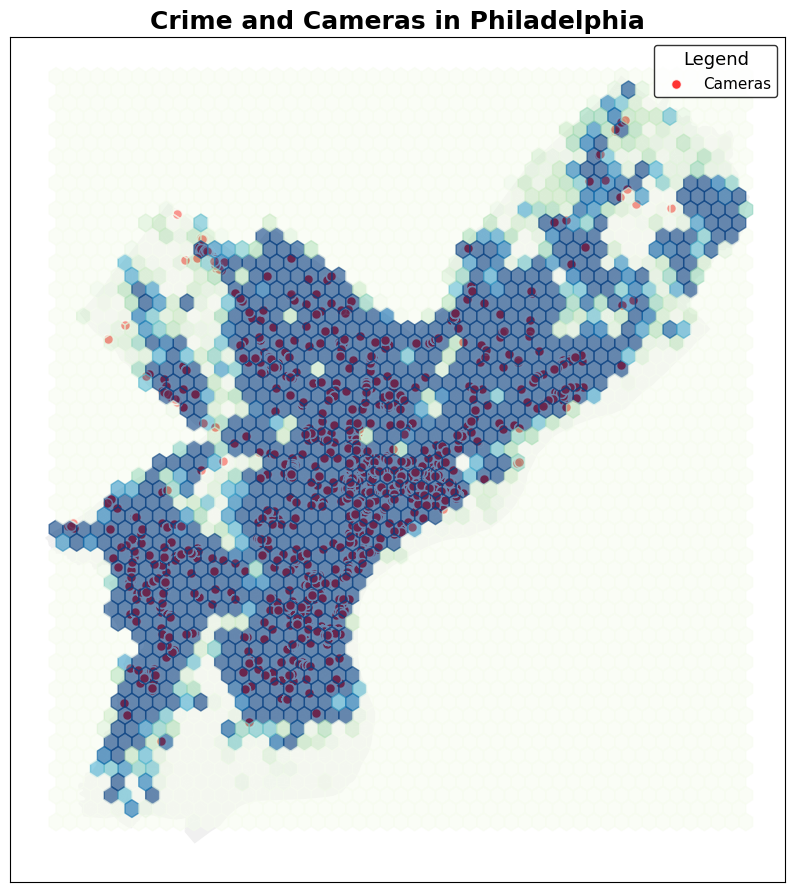

In [ ]:
# Step 1: Convert camera data to GeoDataFrame
camera_geometry = [Point(xy) for xy in zip(phC1['X'], phC1['Y'])]
camera_gdf = gpd.GeoDataFrame(phC1, crs="EPSG:4326", geometry=camera_geometry)

# Step 2: Convert crime data to GeoDataFrame
crime_geometry = [Point(xy) for xy in zip(df_crime['lng'], df_crime['lat'])]
crime_gdf = gpd.GeoDataFrame(df_crime, crs="EPSG:4326", geometry=crime_geometry)

# Step 3: Create a figure and axis to plot
fig, ax = plt.subplots(1, figsize=(10, 12))

# Step 4: Plot the base map (Philly neighborhoods)
Philly_shp.plot(ax=ax, color='#f0f0f0',linewidth = 0 ,edgecolor='#B5C0D0', label="Philadelphia Base Map")

# Step 5: Plot camera locations as scatter points
camera_gdf.plot(ax=ax, color='red', markersize=50, marker='o', label="Cameras", alpha=0.8, edgecolor='white')

# Step 6: Plot crime data using hexbin with increased intensity (you can adjust gridsize and cmap)
x = crime_gdf.geometry.x
y = crime_gdf.geometry.y

# Adjust the color map and set vmin and vmax for intensity control
plt.hexbin(x, y, gridsize=50, cmap='GnBu', alpha=0.6, vmin=1, vmax=50)

# Step 7: Customize the plot
ax.set_title("Crime and Cameras in Philadelphia", fontsize=18, fontweight='bold')
ax.set_xticks([])  # Remove x-axis ticks
ax.set_yticks([])  # Remove y-axis ticks

# Step 8: Add a legend for cameras (since hexbin has its own color mapping)
legend = ax.legend(title="Legend", title_fontsize='13', fontsize='11', loc='upper right', frameon=True)
legend.get_frame().set_edgecolor('black')
legend.get_frame().set_linewidth(1)

# Show the plot
plt.show()


Taking two important public sectors into consideration - Schools and Primary Health Centers

In [ ]:
df_School = pd.read_csv('https://opendata.arcgis.com/api/v3/datasets/d46a7e59e2c246c891fbee778759717e_0/downloads/data?format=csv&spatialRefId=4326')
df_Health = pd.read_csv('https://opendata.arcgis.com/datasets/f87c257e1039470a8a472694c2cd2e4f_0.csv')
df_School['ZIP_CODE'] = df_School['ZIP_CODE'].astype(str)
df_Health['ZIP'] = df_Health['ZIP'].astype(str)

In [ ]:
# Count number of entries in each zip code for schools, health centers, and cameras
school_counts = df_School.groupby('ZIP_CODE').size().reset_index(name='school_count')
health_center_counts = df_Health.groupby('ZIP').size().reset_index(name='health_center_count')
camera_counts = df_BCam.groupby('in_zip').size().reset_index(name='camera_count')

# Merge these counts into the zip code GeoDataFrame
Philly_shp = Philly_shp.merge(school_counts, how='left', left_on='ZCTA5CE20', right_on='ZIP_CODE')
Philly_shp = Philly_shp.merge(health_center_counts, how='left', left_on='ZCTA5CE20', right_on='ZIP')
Philly_shp = Philly_shp.merge(camera_counts, how='left', left_on='ZCTA5CE20', right_on='in_zip')

# Display the merged data to verify
print(Philly_shp[['ZIP_CODE', 'school_count', 'health_center_count','camera_count']].head())



  ZIP_CODE  school_count  health_center_count  camera_count
0    19153           1.0                  NaN           2.0
1    19153           1.0                  NaN           2.0
2    19153           1.0                  NaN           2.0
3    19153           1.0                  NaN           2.0
4    19146           7.0                  2.0          15.0


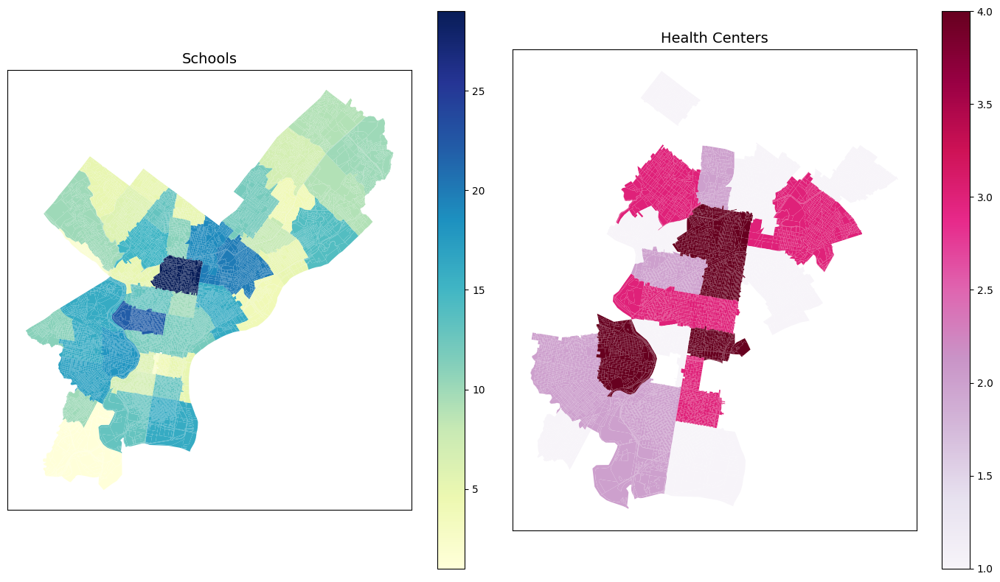

In [ ]:
# Modify the plotting function to remove prominent edges
def plot_choropleth(ax, gdf, column, cmap, title):
    # Plot the GeoDataFrame with no or minimal edge lines
    gdf.plot(column=column, cmap=cmap, linewidth=0, edgecolor='0.8', ax=ax, legend=True)

    # Set title and remove axis ticks
    ax.set_title(title, fontsize=14)
    ax.set_xticks([])
    ax.set_yticks([])

# Create a figure with 2 subplots (side by side)
fig, axes = plt.subplots(1, 2, figsize=(14, 8))

# Plot schools near cameras on the first subplot
plot_choropleth(axes[0], Philly_shp, 'school_count', 'YlGnBu', 'Schools')

# Plot health centers near cameras on the second subplot
plot_choropleth(axes[1], Philly_shp, 'health_center_count', 'PuRd', 'Health Centers')

# Display the side-by-side choropleth maps
plt.tight_layout()
plt.show()


In [ ]:
camera_geometry = [Point(xy) for xy in zip(phC1['X'], phC1['Y'])]
camera_gdf = gpd.GeoDataFrame(phC1, crs="EPSG:4326", geometry=camera_geometry)
geometry = [Point(xy) for xy in zip(df_crime['lng'], df_crime['lat'])]
crime_gdf = gpd.GeoDataFrame(df_crime, crs="EPSG:4326", geometry=geometry)

Visualizing the camera placement around crime hotspots near schools for analyzing optimal coverage

<Axes: title={'center': 'Cameras near Schools'}>

<Axes: title={'center': 'Crimes near Schools'}>

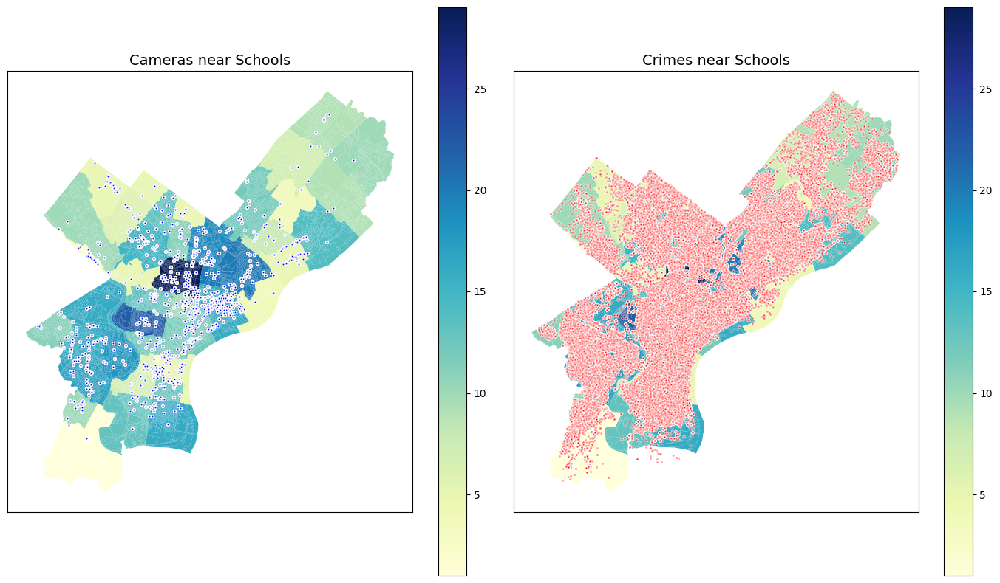

In [ ]:

def plot_School(ax, gdf, column, cmap, title):
    gdf.plot(column=column, cmap=cmap, linewidth=0, edgecolor='0.8', ax=ax, legend=True)

    ax.set_title(title, fontsize=14)
    ax.set_xticks([])
    ax.set_yticks([])

fig, axes = plt.subplots(1, 2, figsize=(14, 8))

plot_School(axes[0], Philly_shp, 'school_count', 'YlGnBu', 'Cameras near Schools')

camera_gdf.plot(ax=axes[0], color='blue', markersize=5, marker='o', label="Cameras", alpha=0.8, edgecolor='white')

plot_School(axes[1], Philly_shp, 'school_count', 'YlGnBu', 'Crimes near Schools')

crime_gdf.plot(ax=axes[1], color='red', markersize=5, alpha=0.4, label="Crime",edgecolor='white')

plt.tight_layout()
plt.show()

Visualizing the camera placement around crime hotspots near health centers for analyzing optimal coverage

<Axes: title={'center': 'Cameras near Health Centers'}>

<Axes: title={'center': 'Crimes near Health Centers'}>

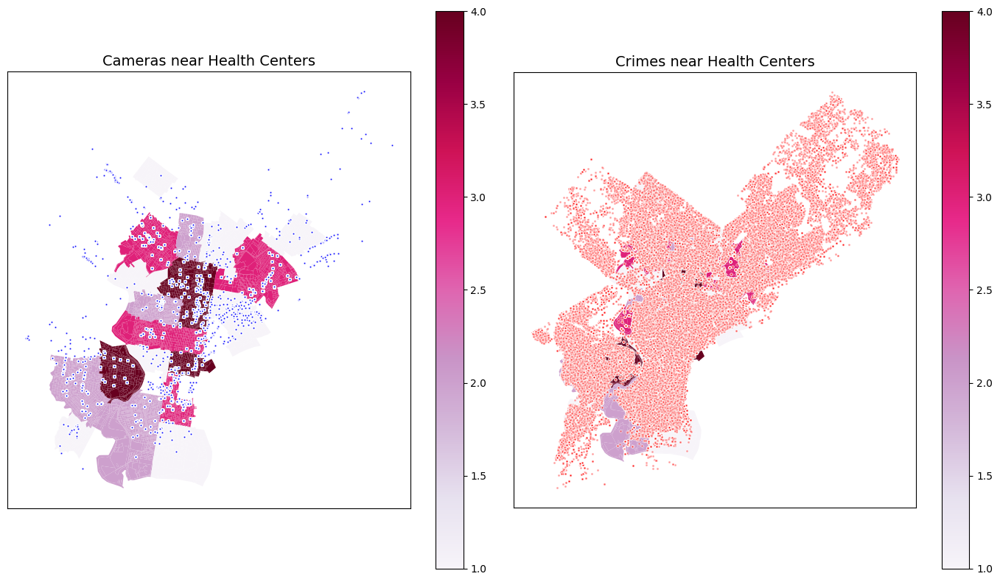

In [ ]:
camera_geometry = [Point(xy) for xy in zip(phC1['X'], phC1['Y'])]
camera_gdf = gpd.GeoDataFrame(phC1, crs="EPSG:4326", geometry=camera_geometry)
geometry = [Point(xy) for xy in zip(df_crime['lng'], df_crime['lat'])]
crime_gdf = gpd.GeoDataFrame(df_crime, crs="EPSG:4326", geometry=geometry)

def plot_hospital(ax, gdf, column, cmap, title):
    gdf.plot(column=column, cmap=cmap, linewidth=0, edgecolor='0.8', ax=ax, legend=True)

    ax.set_title(title, fontsize=14)
    ax.set_xticks([])
    ax.set_yticks([])

fig, axes = plt.subplots(1, 2, figsize=(14, 8))

plot_hospital(axes[0], Philly_shp, 'health_center_count', 'PuRd', 'Cameras near Health Centers')

camera_gdf.plot(ax=axes[0], color='blue', markersize=5, marker='o', label="Cameras", alpha=0.8, edgecolor='white')

plot_hospital(axes[1], Philly_shp, 'health_center_count', 'PuRd', 'Crimes near Health Centers')

crime_gdf.plot(ax=axes[1], color='red', markersize=5, alpha=0.4, label="Crime",edgecolor='white')

plt.tight_layout()
plt.show()

Histogram showing Distribution of Cameras across neighborhoods near Schools and Health Centers

<Figure size 1000x600 with 0 Axes>

<Axes: xlabel='camera_count', ylabel='Count'>

Text(0.5, 1.0, 'Distribution of Cameras in Zip Codes near Schools and Health Centers')

Text(0.5, 0, 'Number of Cameras')

Text(0, 0.5, 'Number of Zip Codes')

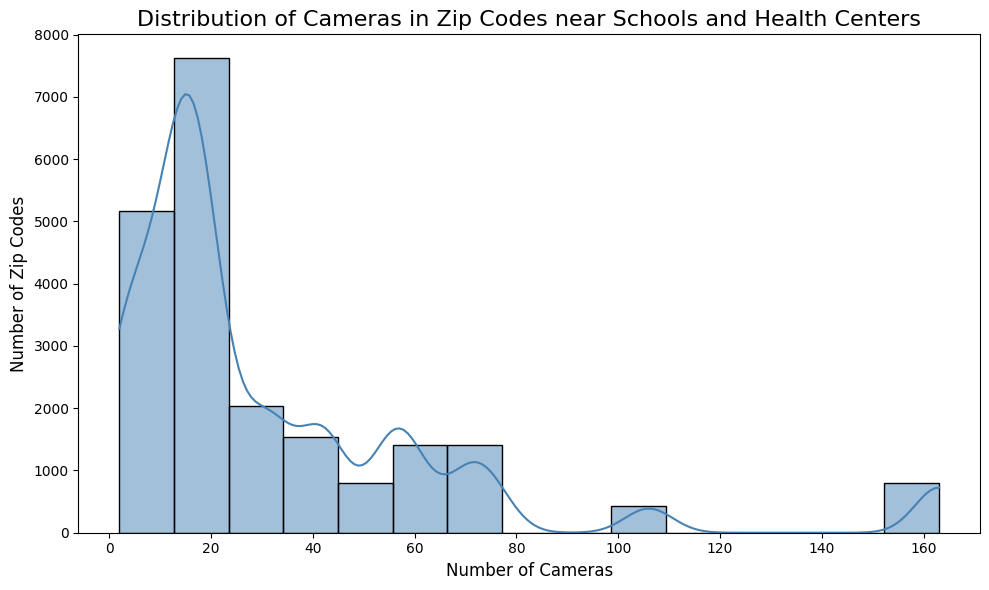

In [ ]:
data_for_histogram = Philly_shp[['ZCTA5CE20', 'camera_count', 'school_count', 'health_center_count']].copy()

data_for_histogram['total_institutions'] = data_for_histogram['school_count'].fillna(0) + data_for_histogram['health_center_count'].fillna(0)

plt.figure(figsize=(10, 6))
sns.histplot(data_for_histogram['camera_count'], bins=15, color='steelblue', kde=True)

plt.title('Distribution of Cameras in Zip Codes near Schools and Health Centers', fontsize=16)
plt.xlabel('Number of Cameras', fontsize=12)
plt.ylabel('Number of Zip Codes', fontsize=12)

plt.tight_layout()
plt.show()

The median household income data is a foundational component of this analysis, offering critical insights into the economic well-being of Philadelphia’s neighborhoods.

In [ ]:
economy_df = pd.read_csv('https://raw.githubusercontent.com/naimish75/GIS/main/Economy.csv')
economy_df.head()

,zip,income_household_median,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
0,19102,115597.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,19103,83988.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,19104,30734.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,19106,126287.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,19107,62280.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
economy_df['zip'] = economy_df['zip'].astype(str)

Economy_Philly = phC1.merge(economy_df, left_on='ZCTA5CE20', right_on='zip', how='left')
Economy_Philly.head()

,Neighborhood,X,Y,ZCTA5CE20,geometry,zip,income_household_median,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
0,Clearview,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",19153,57830.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Clearview,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",19153,39.88391,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Eastwick,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",19153,57830.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Eastwick,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",19153,39.88391,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Penrose,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",19153,57830.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Merging Household Income data with the main dataset

In [ ]:
Economy_Philly=Economy_Philly[['Neighborhood','X','Y','ZCTA5CE20','geometry','income_household_median']]
Economy_Philly.head()

,Neighborhood,X,Y,ZCTA5CE20,geometry,income_household_median
0,Clearview,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",57830.00000
1,Clearview,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",39.88391
2,Eastwick,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",57830.00000
3,Eastwick,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",39.88391
4,Penrose,-75.242744,39.912451,19153,"POLYGON ((-75.25278 39.87699, -75.25206 39.877...",57830.00000


Choropleth map of the income distribution across neighborhoods suitable for visualizing general trends in income variation across the city.

<Axes: >

Text(0.5, 1.0, 'Income Category Map by Neighborhood')

(-75.29649115, -74.93953785000001, 39.8534546, 40.1515414)

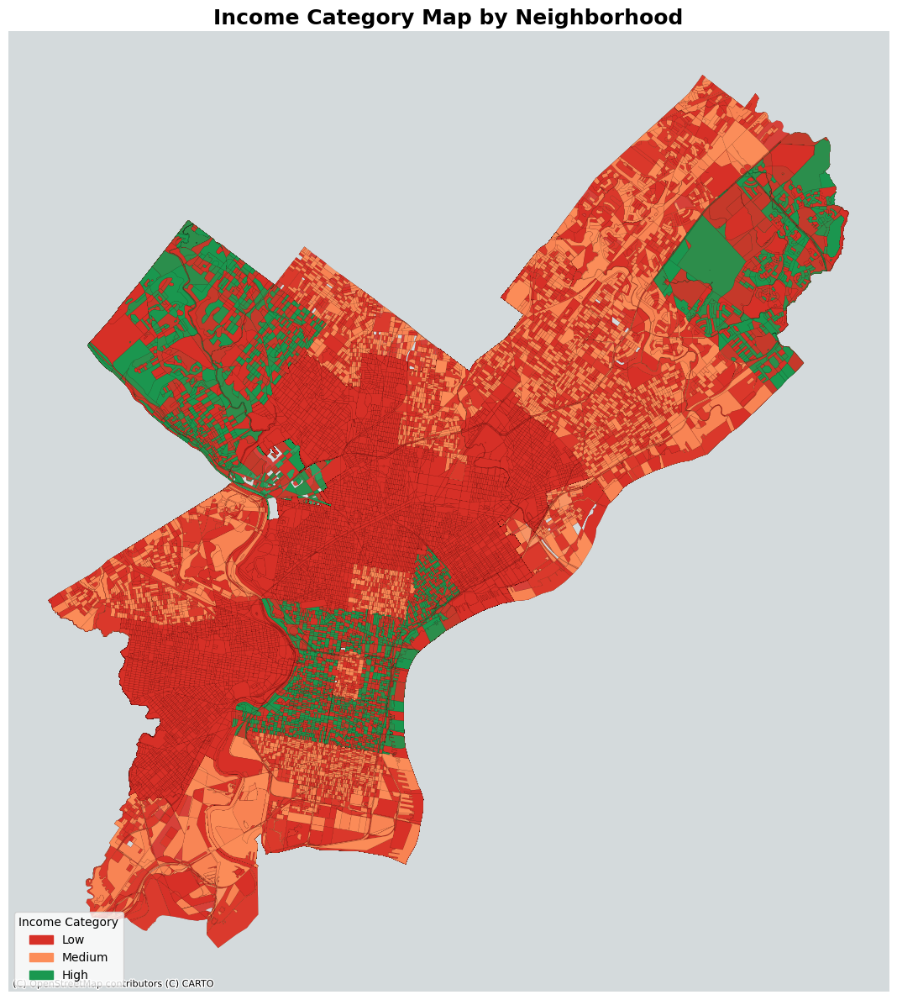

In [ ]:
# Sample and categorize data
Economy_Phily_sample = Economy_Philly.sample(frac=0.3, random_state=42)

def categorize_income_simple(income):
    if income < 40000:
        return 'Low'
    elif 40000 <= income < 70000:
        return 'Medium'
    else:
        return 'High'

Economy_Phily_sample['income_category'] = Economy_Phily_sample['income_household_median'].apply(categorize_income_simple)

# Define refined color scheme for income categories
income_colors = {
    'Low': '#D73027',  # Red for low income
    'Medium': '#FC8D59',  # Orange for medium income
    'High': '#1A9850'  # Green for high income
}

# Plot the map
fig, ax = plt.subplots(1, 1, figsize=(14, 12))

# Plot neighborhoods with income categories, adding transparency and thinner borders
Economy_Phily_sample.plot(
    ax=ax,
    color=Economy_Phily_sample['income_category'].map(income_colors),
    edgecolor='black',
    linewidth=0.05,  # Thin borders to reduce clutter
    alpha=0.9  # Slight transparency for a softer appearance
)

# Use CartoDB.Positron basemap with a low zoom level to reduce detail
ctx.add_basemap(
    ax,
    source=ctx.providers.CartoDB.Positron,  # Simplified basemap
    zoom=10  # Reduced zoom level for only major roads
)

# Create a legend manually
legend_elements = [mpatches.Patch(color=income_colors[cat], label=cat) for cat in income_colors.keys()]
ax.legend(handles=legend_elements, title="Income Category", loc='lower left', fontsize=10, frameon=True, fancybox=True, framealpha=0.8)

# Customize the plot
ax.set_title("Income Category Map by Neighborhood", fontsize=18, fontweight='bold')
ax.axis("off")  # Hide axes for a cleaner look

plt.tight_layout()
plt.show()


<ipython-input-15-5085f7435dcd>:4: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: EPSG:4269

  crime_gdf_neighborhoods = gpd.sjoin(crime_gdf, Economy_Phily_sample[['Neighborhood', 'geometry']], how="left", predicate="within")


<Figure size 800x600 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Correlation between Median Household Income and Crime Count')

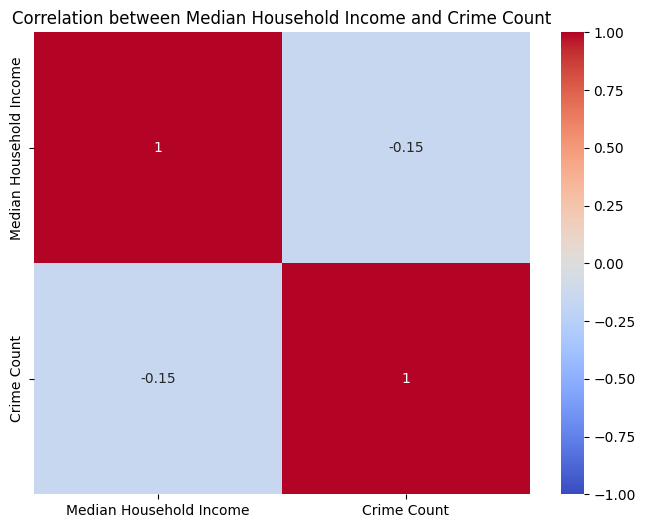

In [ ]:
Economy_Philly_sample = Economy_Phily_sample.to_crs("EPSG:4326")

crime_gdf_neighborhoods = gpd.sjoin(crime_gdf, Economy_Phily_sample[['Neighborhood', 'geometry']], how="left", predicate="within")

crime_counts = crime_gdf_neighborhoods.groupby("Neighborhood").size().reset_index(name="crime_count")

income_crime_df = Economy_Phily_sample.merge(crime_counts, on="Neighborhood", how="left")

correlation_matrix = income_crime_df[['income_household_median', 'crime_count']].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap="coolwarm",
    xticklabels=['Median Household Income', 'Crime Count'],
    yticklabels=['Median Household Income', 'Crime Count'],
    vmin=-1,
    vmax=1)
plt.title("Correlation between Median Household Income and Crime Count")
plt.show()

The correlation is weak (close to 0), it indicates that neighborhoods with higher median income might tend to have slightly lower crime rates.


This insight suggests that economic factors could play a role in influencing crime, further analysis might consider other socioeconomic factors to get a more comprehensive view.

Now let's visualize neighborhoods based on "Low Income", Medium Income", and "High Income" with their respective Crime Rates through a interactive pie-chart

In [ ]:
income_crime_df['income_level'] = pd.cut(
    income_crime_df['income_household_median'],
    bins=[0, 40000, 70000, income_crime_df['income_household_median'].max()],
    labels=['Low Income', 'Medium Income', 'High Income']
)

# Select top neighborhoods by crime count within each income level
top_low_income = income_crime_df[income_crime_df['income_level'] == 'Low Income'].nlargest(3, 'crime_count')
top_medium_income = income_crime_df[income_crime_df['income_level'] == 'Medium Income'].nlargest(3, 'crime_count')
top_high_income = income_crime_df[income_crime_df['income_level'] == 'High Income'].nlargest(4, 'crime_count')

# Combine the selections to get a mix of high, medium, and low income neighborhoods
top_neighborhoods_mixed = pd.concat([top_low_income, top_medium_income, top_high_income])

# Create the pie chart with the filtered neighborhoods
fig = px.pie(
    top_neighborhoods_mixed,
    names="Neighborhood",
    values="crime_count",
    color="income_level",
    color_discrete_map={
        "Low Income": "lightcoral",
        "Medium Income": "gold",
        "High Income": "lightgreen"
    },
    title="Top Neighborhoods by Crime Count Across Different Income Levels"
)

# Explode slices for high crime counts
fig_1 = fig.update_traces(
    pull=[0.1 if count > top_neighborhoods_mixed['crime_count'].quantile(0.75) else 0 for count in top_neighborhoods_mixed['crime_count']],
    textinfo='percent+label',
    hovertemplate="<b>%{label}</b><br>Crime Count: %{value}<br>Income Level: %{color}"
)

# Display the figure
fig_1.show()

Assessing graduation rates from selected Philadelphia schools as a proxy for neighborhood educational outcomes

Source: https://public.tableau.com/app/profile/padeptofed/viz/GraduationDataandStatistics/GraduationandDropout

In [ ]:
df_grad = pd.read_excel('https://raw.githubusercontent.com/naimish75/GIS/main/Graduation_Rates.xlsx')
df_grad.head()

,AUN,LEA,SCHOOL CODE,SCHOOL,GRADUATE COUNT,COLLEGE BOUND,TOTAL COLLEGE BOUND %,2- OR 4-YEAR COLLEGE OR UNIVERSITY,2- OR 4-YEAR UNIVERSITY %,TOTAL POSTSECONDARY BOUND,TOTAL POSTSECONDARY BOUND %,NON-DEGREE-GRANTING POSTSECONDARY SCHOOL,NON-DEGREE-GRANTING POSTSECONDARY SCHOOL %,SPECIALIZED ASSOCIATE DEGREE GRANTING INSTITUTION,SPECIALIZED ASSOCIATE DEGREE GRANTING INSTITUTION %
0,100510000.0,First Philadelphia Preparatory CS,7744.0,First Philadelphia Preparatory CS,82,8,0.097561,8,0.097561,9,0.109756,1,0.012195,0,0.0
1,NaN,NaN,9999.0,First Philadelphia Preparatory CS,1,0,0.000000,0,0.000000,0,0.000000,0,0.000000,0,0.0
2,NaN,First Philadelphia Preparatory CS,NaN,NaN,83,8,0.096386,8,0.096386,9,0.108434,1,0.012048,0,0.0
3,114514135.0,Sankofa Freedom Academy CS,8083.0,Sankofa Freedom Academy CS,45,32,0.711111,32,0.711111,39,0.866667,7,0.155556,0,0.0
4,NaN,NaN,9999.0,Sankofa Freedom Academy CS,2,0,0.000000,0,0.000000,0,0.000000,0,0.000000,0,0.0


Constructing Radar Charts to break down graduation metrics (e.g., college-bound rates, postsecondary enrollment). These metrics provided insight into educational access and success rates across different neighborhoods.

<ipython-input-19-8fb81b32ff15>:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(['0%', '20%', '40%', '60%', '80%', '100%'], color="gray", fontsize=10)


[Text(0, 0.2, '0%'),
 Text(0, 0.4, '20%'),
 Text(0, 0.6000000000000001, '40%'),
 Text(0, 0.8, '60%'),
 Text(0, 1.0, '80%')]

[Text(0.0, 0, 'TOTAL COLLEGE BOUND %'),
 Text(1.2566370614359172, 0, '2- OR 4-YEAR UNIVERSITY %'),
 Text(2.5132741228718345, 0, 'TOTAL POSTSECONDARY BOUND %'),
 Text(3.7699111843077517, 0, 'NON-DEGREE-GRANTING POSTSECONDARY SCHOOL %'),
 Text(5.026548245743669, 0, 'SPECIALIZED ASSOCIATE DEGREE GRANTING INSTITUTION %')]

Text(0.5, 1.0, 'Graduation Rate Breakdown by Category for Selected Schools')

[None, None, None]

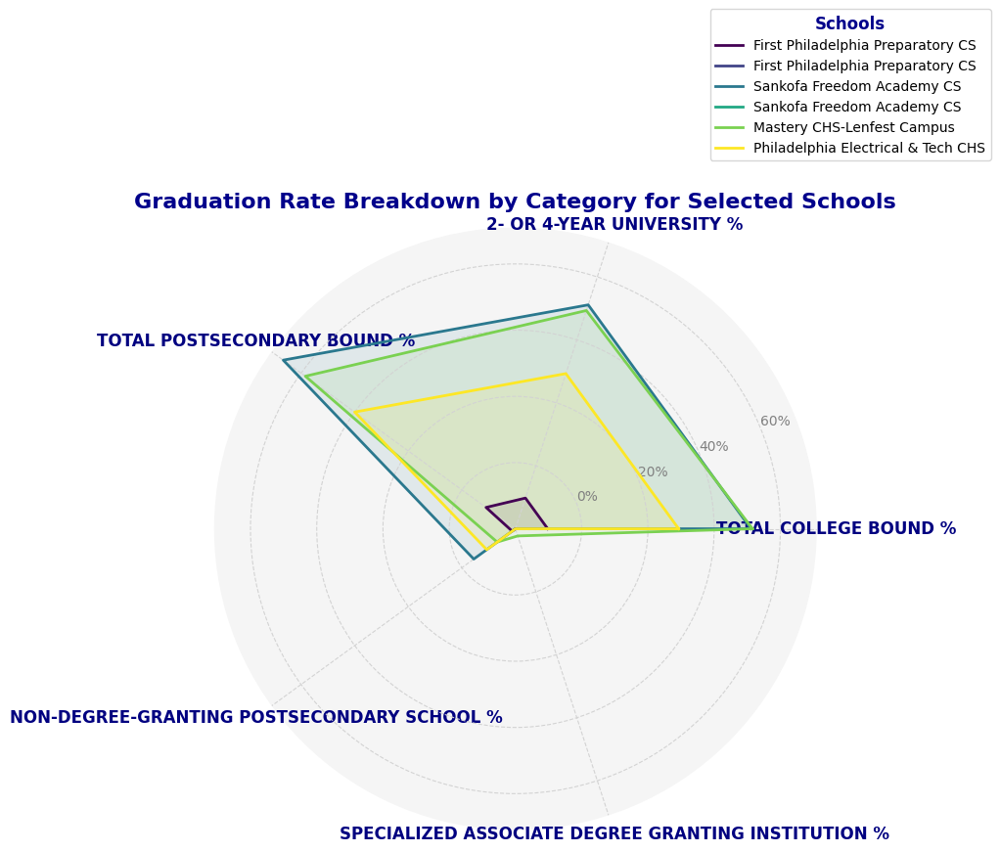

In [ ]:
selected_schools = df_grad[df_grad['SCHOOL'].isin(['First Philadelphia Preparatory CS', 'Sankofa Freedom Academy CS',
                                                   'Mastery CHS-Lenfest Campus', 'Philadelphia Electrical & Tech CHS'])]

# Prepare the data for radar chart
categories = ['TOTAL COLLEGE BOUND %', '2- OR 4-YEAR UNIVERSITY %', 'TOTAL POSTSECONDARY BOUND %',
              'NON-DEGREE-GRANTING POSTSECONDARY SCHOOL %', 'SPECIALIZED ASSOCIATE DEGREE GRANTING INSTITUTION %']
num_vars = len(categories)

# Create angles for the radar chart
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Complete the loop

# Define colors for each school
colors = plt.cm.viridis(np.linspace(0, 1, len(selected_schools)))

# Plotting
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

for i, (index, row) in enumerate(selected_schools.iterrows()):
    values = row[categories].values.flatten().tolist()
    values += values[:1]  # Repeat the first value to close the chart
    ax.plot(angles, values, color=colors[i], linewidth=2, linestyle='solid', label=row['SCHOOL'])
    ax.fill(angles, values, color=colors[i], alpha=0.1)

# Add labels and title
ax.set_yticklabels(['0%', '20%', '40%', '60%', '80%', '100%'], color="gray", fontsize=10)
ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories, fontsize=12, color="navy", weight='bold')
plt.title('Graduation Rate Breakdown by Category for Selected Schools', size=16, color='darkblue', weight='bold')

# Customize legend
legend = plt.legend(loc='lower right', bbox_to_anchor=(1.3, 1.1), fontsize=10, title="Schools")
plt.setp(legend.get_title(), fontsize=12, weight='bold', color='darkblue')

# Adjust the radial grid and axes for aesthetics
ax.spines['polar'].set_visible(False)
ax.grid(color="lightgray", linestyle='--')
ax.set_facecolor("whitesmoke")

plt.show()

In [ ]:
# Clear existing plots (helps in interactive environments)
fig1 = go.Figure()
fig1.data = []

# Process percent columns to numeric values
percent_columns = ['TOTAL COLLEGE BOUND %', '2- OR 4-YEAR UNIVERSITY %', 'TOTAL POSTSECONDARY BOUND %',
                   'NON-DEGREE-GRANTING POSTSECONDARY SCHOOL %', 'SPECIALIZED ASSOCIATE DEGREE GRANTING INSTITUTION %']
for col in percent_columns:
    df_grad[col] = df_grad[col].astype(str).str.rstrip('%').astype(float)

# Calculate totals
total_graduates = df_grad['GRADUATE COUNT'].sum()
total_college_bound = df_grad['COLLEGE BOUND'].sum()
non_college_bound = total_graduates - total_college_bound

# Pie Chart with custom colors
fig1 = px.pie(
    names=["College Bound", "Not College Bound"],
    values=[total_college_bound, non_college_bound],
    title="Overall College Bound vs Non-College Bound Students",
    color_discrete_sequence=["#00aaff", "#ff6347"],

)


fig1.show()


Visualizing Overall Graduation Rate and Dropout Rate through a gauge chart

In [ ]:
# Calculate overall graduation and dropout rates
total_graduates = df_grad['GRADUATE COUNT'].sum()
total_students = 73420
overall_graduation_rate = (total_graduates / total_students) * 100
overall_dropout_rate = 100 - overall_graduation_rate  # Complementary rate as a percentage

# Create the dual gauge chart
fig = go.Figure()

# Graduation rate gauge (left)
fig_1 = fig.add_trace(go.Indicator(
    mode="gauge+number",
    value=overall_graduation_rate,
    title={'text': "Graduation Rate", 'font': {'size': 16}},
    domain={'x': [0, 0.45], 'y': [0, 1]},  # Position on the left
    gauge={
        'axis': {'range': [0, 100]},
        'bar': {'color': "blue"},
        'steps': [
            {'range': [0, 50], 'color': "lightgray"},
            {'range': [50, 75], 'color': "lightblue"},
            {'range': [75, 100], 'color': "royalblue"}
        ],
        'threshold': {
            'line': {'color': "red", 'width': 4},
            'thickness': 0.75,
            'value': overall_graduation_rate}
    }
))

# Dropout rate gauge (right)
fig_2 = fig_1.add_trace(go.Indicator(
    mode="gauge+number",
    value=overall_dropout_rate,
    title={'text': "Dropout Rate", 'font': {'size': 16}},
    domain={'x': [0.55, 1], 'y': [0, 1]},  # Position on the right
    gauge={
        'axis': {'range': [0, 100]},
        'bar': {'color': "crimson"},
        'steps': [
            {'range': [0, 50], 'color': "lightgray"},
            {'range': [50, 75], 'color': "salmon"},
            {'range': [75, 100], 'color': "red"}
        ],
        'threshold': {
            'line': {'color': "darkred", 'width': 4},
            'thickness': 0.75,
            'value': overall_dropout_rate}
    }
))

# Customize layout to ensure only one combined figure is displayed
fig_3 = fig_2.update_layout(
    title_text="Overall Graduation and Dropout Rates",
    paper_bgcolor="whitesmoke",
    font={'color': "darkblue", 'family': "Arial"},
    margin={'t': 60, 'b': 20, 'l': 20, 'r': 20}
)

# Show the single, dual-gauge figure
fig_3.show()


Let's dive into Housing Rates!
Housing values are a direct reflection of a neighborhood’s economic condition, thereby revealing the spatial distribution of wealth and economic inequality across the county.

In [ ]:
df_house = pd.read_csv('https://opendata-downloads.s3.amazonaws.com/opa_properties_public.csv')
df_house = df_house[[
    'location', 'zip_code', 'census_tract', 'geographic_ward',
    'number_of_bathrooms', 'number_of_bedrooms', 'number_of_rooms',
    'number_stories', 'total_livable_area', 'year_built',
    'market_value', 'sale_date', 'sale_price',
    'building_code_description', 'category_code_description',
    'quality_grade', 'owner_1', 'mailing_city_state'
]]
df_house.head()

<ipython-input-17-894d3611576d>:1: DtypeWarning: Columns (4,16,25,27,76) have mixed types. Specify dtype option on import or set low_memory=False.
  df_house = pd.read_csv('https://opendata-downloads.s3.amazonaws.com/opa_properties_public.csv')


,location,zip_code,census_tract,geographic_ward,number_of_bathrooms,number_of_bedrooms,number_of_rooms,number_stories,total_livable_area,year_built,market_value,sale_date,sale_price,building_code_description,category_code_description,quality_grade,owner_1,mailing_city_state
0,925 W SOMERSET ST,19133.0,175.0,37.0,NaN,NaN,NaN,NaN,NaN,NaN,33900.0,2070-10-05 00:00:00-05:00,1.0,VACANT LAND COMMER < ACRE,VACANT LAND,NaN,CITY OF PHILA,PHILADELPHIA PA
1,1755 N 31ST ST,19121.0,149.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,49700.0,2070-10-05 00:00:00-05:00,1.0,VACANT LAND RESIDE < ACRE,VACANT LAND,NaN,CITY OF PHILA,PHILADELPHIA PA
2,1700 N NEWKIRK ST,19121.0,149.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,48800.0,2070-09-30 00:00:00-05:00,1.0,VACANT LAND RESIDE < ACRE,VACANT LAND,NaN,REDEVELOPMENT AUTHORITY,PHILADELPHIA PA
3,2028 N WOODSTOCK ST,19121.0,152.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,51400.0,2070-09-30 00:00:00-05:00,1.0,VACANT LAND RESIDE < ACRE,VACANT LAND,NaN,REDEVELOPMENT AUTHORITY,PHILADELPHIA PA
4,1941 N 20TH ST,19121.0,152.0,32.0,NaN,NaN,NaN,NaN,NaN,NaN,86300.0,2070-09-30 00:00:00-05:00,1.0,VACANT LAND RESIDE < ACRE,VACANT LAND,NaN,REDEVELOPMENT AUTHORITY,PHILADELPHIA PA


In [ ]:
df_house = df_house.dropna(subset=['zip_code'])
income_crime_df = income_crime_df.dropna(subset=['ZCTA5CE20'])

# Step 2: Drop rows with infinite values in 'zip_code' or 'ZCTA5CE20'
df_house = df_house[~df_house['zip_code'].isin([np.inf, -np.inf])]
income_crime_df = income_crime_df[~income_crime_df['ZCTA5CE20'].isin([np.inf, -np.inf])]

# Step 3: Convert to string by first ensuring numeric conversion
df_house['zip_code'] = pd.to_numeric(df_house['zip_code'], errors='coerce').dropna().astype(int).astype(str)
income_crime_df['ZCTA5CE20'] = pd.to_numeric(income_crime_df['ZCTA5CE20'], errors='coerce').dropna().astype(int).astype(str)

In [ ]:
sample_size = 10000  # Adjust this as needed
df_house_sample = df_house.sample(n=sample_size, random_state=1)
income_crime_sample = income_crime_df.sample(n=sample_size, random_state=1)

# Convert columns to strings for matching
income_crime_sample['ZCTA5CE20'] = income_crime_sample['ZCTA5CE20'].astype(str)
df_house_sample['zip_code'] = df_house_sample['zip_code'].astype(str)

# Select only essential columns for visualization
columns_to_keep = [
    'ZCTA5CE20', 'zip_code', 'location', 'market_value', 'sale_price',
    'number_of_bathrooms', 'number_of_bedrooms', 'quality_grade'
]


# Perform the join on the smaller sample
income_crime_sample = income_crime_sample.merge(df_house_sample, left_on='ZCTA5CE20', right_on='zip_code', how='inner')

# Display the resulting DataFrame
income_crime_sample.head()

,Neighborhood,X,Y,ZCTA5CE20,geometry,income_household_median,crime_count,location,zip_code,census_tract,...,total_livable_area,year_built,market_value,sale_date,sale_price,building_code_description,category_code_description,quality_grade,owner_1,mailing_city_state
0,Richmond,-75.116773,39.991293,19134,"POLYGON ((-75.11393 39.99064, -75.11238 39.991...",37821.0,841361,3116 TILTON ST,19134,180.0,...,940.0,1920.0,189100.0,2004-06-01 00:00:00-04:00,1.0,ROW 2 STY MASONRY,SINGLE FAMILY,C,SODUL JOSEPH,PHILADELPHIA PA
1,Richmond,-75.116773,39.991293,19134,"POLYGON ((-75.11393 39.99064, -75.11238 39.991...",37821.0,841361,3391-95 TULIP ST,19134,382.0,...,1168.0,1910.0,187500.0,1997-06-11 00:00:00-04:00,30000.0,ROW W/GAR 2 STY MASONRY,SINGLE FAMILY,C,HENRY MARK,PHILADELPHIA PA
2,Richmond,-75.116773,39.991293,19134,"POLYGON ((-75.11393 39.99064, -75.11238 39.991...",37821.0,841361,3175 JANNEY ST,19134,179.0,...,990.0,1920.0,156400.0,1996-04-18 00:00:00-04:00,38500.0,ROW 2 STY MASONRY,SINGLE FAMILY,C,DOROSZ MICHAEL,PHILADELPHIA PA
3,Richmond,-75.116773,39.991293,19134,"POLYGON ((-75.11393 39.99064, -75.11238 39.991...",37821.0,841361,3003 MEMPHIS ST,19134,179.0,...,920.0,1925.0,141500.0,2020-09-21 00:00:00-04:00,130000.0,ROW 2 STY MASONRY,SINGLE FAMILY,C,BLUEBERRY HOMES LLC,PHILADELPHIA PA
4,Richmond,-75.116773,39.991293,19134,"POLYGON ((-75.11393 39.99064, -75.11238 39.991...",37821.0,841361,121 E ONTARIO ST,19134,195.0,...,1290.0,1930.0,88200.0,1995-08-28 00:00:00-04:00,1.0,ROW 2 STY MASONRY,SINGLE FAMILY,C,FANTAUZZI IVETTE NARVAEZ,PHILADELPHIA PA


In [ ]:
income_crime_sample = income_crime_sample.sample(n=10000, random_state=42)

len(income_crime_sample)

10000

Scatter Plot with a Regression line to explore the relationship between Crime Count and Housing Market Value across neighborhoods

In [ ]:
# Ensure 'log_crime_count' and 'log_market_value' exist in your dataframe
income_crime_sample['log_crime_count'] = np.log1p(income_crime_sample['crime_count'])
income_crime_sample['log_market_value'] = np.log1p(income_crime_sample['market_value'])

# Add jitter to the scatter plot points to reduce overlap
income_crime_sample['log_crime_count_jittered'] = income_crime_sample['log_crime_count'] + np.random.normal(0, 0.05, income_crime_sample.shape[0])
income_crime_sample['log_market_value_jittered'] = income_crime_sample['log_market_value'] + np.random.normal(0, 0.05, income_crime_sample.shape[0])

# Create the scatter plot with jittered points
fig = px.scatter(
    income_crime_sample,
    x='log_crime_count_jittered',
    y='log_market_value_jittered',
    opacity=0.3,
    size_max=5,
    color_discrete_sequence=['#6A1E55'],
    labels={"log_crime_count_jittered": "Crime Count", "log_market_value_jittered": "Market Value"},
    title="Relationship Between Crime Count and Market Value"
)

# Calculate the regression line using the original (non-jittered) columns
slope, intercept = np.polyfit(income_crime_sample['log_crime_count'], income_crime_sample['log_market_value'], 1)
x_vals = np.linspace(income_crime_sample['log_crime_count'].min(), income_crime_sample['log_crime_count'].max(), 100)
y_vals = slope * x_vals + intercept

# Ensure x_vals and y_vals are within the same range as the plot


# Show the interactive plot
fig.show()


 The scatter points’ distribution around the regression line shows the strength of the relationship. A tight cluster around the line indicates a stronger correlation, while a more dispersed set of points suggests a weaker relationship.

Examinig relationship between Crime Count, Housing Market Value, and Median Household Income through an interactive 3-D Scatterplot

In [ ]:
# 3D scatter plot with updated labels
fig = px.scatter_3d(
    income_crime_sample,
    x='log_crime_count',
    y='log_market_value',
    z='income_household_median',
    color='income_household_median',
    size='crime_count',
    title="3D Plot: Market Value, Crime Count, and Household Median Income",
    labels={
        'log_crime_count': 'Log of Crime Count',
        'log_market_value': 'Log of Market Value',
        'income_household_median': 'Median Household Income',
        'crime_count': 'Crime Count'
    }
)

fig.show()


Identifying the relationships between housing market values, crime rates, and income levels to identify patterns that correlate with neighborhood development.

Text(0.5, 1.02, 'Scatter Plot Matrix of Housing Value, Crime Count, Income')

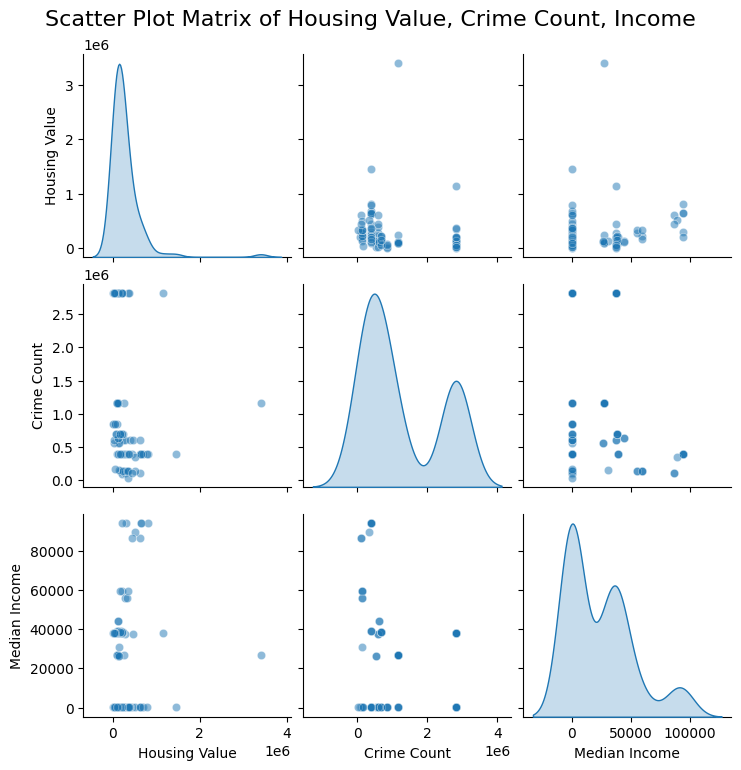

In [ ]:
data = income_crime_sample[['market_value', 'crime_count', 'income_household_median']]
data.columns = ['Housing Value', 'Crime Count', 'Median Income']

# Plot the scatter plot matrix
sns.pairplot(data, diag_kind="kde", plot_kws={"alpha": 0.5})
plt.suptitle("Scatter Plot Matrix of Housing Value, Crime Count, Income", y=1.02, fontsize=16)
plt.show()

Analyzing the correlation through a Heatmap!

In [ ]:
corr_data = income_crime_sample[['crime_count', 'income_household_median', 'market_value']].corr()

corr_long = corr_data.stack().reset_index()
corr_long.columns = ['Variable1', 'Variable2', 'Correlation']

fig = px.density_heatmap(
    corr_long, x='Variable1', y='Variable2', z='Correlation',
    color_continuous_scale='deep',
    title="Correlation Heatmap of Crime Count, Median Income, and Market Value"
)

fig_1 = fig.update_layout(
    width=600, height=500,
    xaxis_title="Variable",
    yaxis_title="Variable",
    coloraxis_colorbar=dict(title="Correlation")
)

fig_1.show()


##Diving into Folium!!

Classifying neighborhoods into Developed, Developing, or Under-Developed zones based on housing values, income levels, and crime rates.

Method of Classification - Used a composite scoring approach, normalizing each indicator (income, housing value, crime) and assigning weights to calculate a development score. This approach provided a single metric to gauge neighborhood development.

In [ ]:
weights = {
    'income_household_median': 0.3,  # Higher income is better
    'market_value': 0.2,            # Higher housing value is better, moderate weight
    'crime_count': -0.2             # Lower crime count is better, negative weight
}
# Step 1: Log transform and normalize the metrics
income_crime_sample['log_income'] = np.log1p(income_crime_sample['income_household_median'])
income_crime_sample['log_market_value'] = np.log1p(income_crime_sample['market_value'])
income_crime_sample['log_crime'] = np.log1p(income_crime_sample['crime_count'])

income_crime_sample['income_normalized'] = income_crime_sample['log_income'] / income_crime_sample['log_income'].max()
income_crime_sample['housing_normalized'] = income_crime_sample['log_market_value'] / income_crime_sample['log_market_value'].max()
income_crime_sample['crime_normalized'] = 1 - (income_crime_sample['log_crime'] / income_crime_sample['log_crime'].max())

# Step 2: Calculate composite score
income_crime_sample['composite_score'] = (
    income_crime_sample['income_normalized'] * weights['income_household_median'] +
    income_crime_sample['housing_normalized'] * weights['market_value'] +
    income_crime_sample['crime_normalized'] * abs(weights['crime_count'])
)

# Step 3: Define thresholds for Developed, Developing, and Underdeveloped neighborhoods
income_crime_sample['development_category'] = pd.qcut(
    income_crime_sample['composite_score'],
    q=[0, 0.33, 0.66, 1],
    labels=['Underdeveloped', 'Developing', 'Developed']
)

# Step 4: Create a Folium map centered on Philadelphia
map_center = [income_crime_sample.geometry.centroid.y.mean(), income_crime_sample.geometry.centroid.x.mean()]
m = folium.Map(location=map_center, zoom_start=12)

# Step 5: Add markers for each neighborhood based on its development category
for idx, row in income_crime_sample.iterrows():
    color = 'green' if row['development_category'] == 'Developed' else \
            'orange' if row['development_category'] == 'Developing' else 'red'
    folium.Marker(
        location=[row.geometry.centroid.y, row.geometry.centroid.x],
        popup=folium.Popup(
            f"<strong>{row['development_category']} Neighborhood</strong><br>"
            f"Neighborhood: {row['Neighborhood']}<br>"
            f"Median Income: ${row['income_household_median']:,}<br>"
            f"Housing Value: ${row['market_value']:,}<br>"
            f"Crime Count: {row['crime_count']}", max_width=300
        ),
        icon=folium.Icon(color=color),
    ).add_to(m)

# Display the map
m



<ipython-input-24-01c2be4362ae>:28: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




Visualizing Top 3 - Developed, Developing, and Under Developed Neighborhoods in the county of Philadelphia!

In [ ]:

# Step 1: Log transform and normalize the metrics
income_crime_sample['log_income'] = np.log1p(income_crime_sample['income_household_median'])
income_crime_sample['log_market_value'] = np.log1p(income_crime_sample['market_value'])
income_crime_sample['log_crime'] = np.log1p(income_crime_sample['crime_count'])

income_crime_sample['income_normalized'] = income_crime_sample['log_income'] / income_crime_sample['log_income'].max()
income_crime_sample['housing_normalized'] = income_crime_sample['log_market_value'] / income_crime_sample['log_market_value'].max()
income_crime_sample['crime_normalized'] = 1 - (income_crime_sample['log_crime'] / income_crime_sample['log_crime'].max())

# Step 2: Calculate composite score
income_crime_sample['composite_score'] = (
    income_crime_sample['income_normalized'] * weights['income_household_median'] +
    income_crime_sample['housing_normalized'] * weights['market_value'] +
    income_crime_sample['crime_normalized'] * abs(weights['crime_count'])
)

# Step 3: Define thresholds for Developed, Developing, and Underdeveloped neighborhoods
income_crime_sample['development_category'] = pd.qcut(
    income_crime_sample['composite_score'],
    q=[0, 0.33, 0.66, 1],
    labels=['Underdeveloped', 'Developing', 'Developed']
)

# Select the top 5 neighborhoods in each category
top_developed = income_crime_sample[income_crime_sample['development_category'] == 'Developed'].nlargest(5, 'composite_score')
top_developing = income_crime_sample[income_crime_sample['development_category'] == 'Developing'].nlargest(5, 'composite_score')
top_underdeveloped = income_crime_sample[income_crime_sample['development_category'] == 'Underdeveloped'].nsmallest(5, 'composite_score')

# Combine the top neighborhoods into one dataframe
top_neighborhoods = pd.concat([top_developed, top_developing, top_underdeveloped])

# Step 4: Create a Folium map centered on Philadelphia
map_center = [income_crime_sample.geometry.centroid.y.mean(), income_crime_sample.geometry.centroid.x.mean()]
m = folium.Map(location=map_center, zoom_start=12)

# Step 5: Add markers for each top neighborhood based on its development category
for idx, row in top_neighborhoods.iterrows():
    color = 'green' if row['development_category'] == 'Developed' else \
            'orange' if row['development_category'] == 'Developing' else 'red'
    folium.Marker(
        location=[row.geometry.centroid.y, row.geometry.centroid.x],
        popup=folium.Popup(
            f"<strong>{row['development_category']} Neighborhood</strong><br>"
            f"Neighborhood: {row['Neighborhood']}<br>"
            f"Median Income: ${row['income_household_median']:,}<br>"
            f"Housing Value: ${row['market_value']:,}<br>"
            f"Crime Count: {row['crime_count']}", max_width=300
        ),
        icon=folium.Icon(color=color),
    ).add_to(m)

# Display the map
m

<ipython-input-26-f8b6135aac62>:38: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




Visualizing the most Developed and Under Developed Neighborhood!

In [ ]:
# Step 1: Log transform and normalize the metrics
income_crime_sample['log_income'] = np.log1p(income_crime_sample['income_household_median'])
income_crime_sample['log_market_value'] = np.log1p(income_crime_sample['market_value'])
income_crime_sample['log_crime'] = np.log1p(income_crime_sample['crime_count'])

income_crime_sample['income_normalized'] = income_crime_sample['log_income'] / income_crime_sample['log_income'].max()
income_crime_sample['housing_normalized'] = income_crime_sample['log_market_value'] / income_crime_sample['log_market_value'].max()
income_crime_sample['crime_normalized'] = 1 - (income_crime_sample['log_crime'] / income_crime_sample['log_crime'].max())

# Step 2: Calculate composite score
income_crime_sample['composite_score'] = (
    income_crime_sample['income_normalized'] * weights['income_household_median'] +
    income_crime_sample['housing_normalized'] * weights['market_value'] +
    income_crime_sample['crime_normalized'] * abs(weights['crime_count'])
)

# Step 3: Identify the most developed and most underdeveloped neighborhoods
most_developed = income_crime_sample.loc[income_crime_sample['composite_score'].idxmax()]
most_underdeveloped = income_crime_sample.loc[income_crime_sample['composite_score'].idxmin()]

# Step 4: Create a Folium map centered between the two neighborhoods
map_center = [(most_developed.geometry.centroid.y + most_underdeveloped.geometry.centroid.y) / 2,
              (most_developed.geometry.centroid.x + most_underdeveloped.geometry.centroid.x) / 2]
m = folium.Map(location=map_center, zoom_start=12)

# Step 5: Add markers for the most developed and most underdeveloped neighborhoods
# Most Developed Neighborhood Marker
folium.Marker(
    location=[most_developed.geometry.centroid.y, most_developed.geometry.centroid.x],
    popup=folium.Popup(f"<strong>Most Developed Neighborhood</strong><br>"
                       f"Neighborhood: {most_developed['Neighborhood']}<br>"
                       f"Median Income: ${most_developed['income_household_median']:,}<br>"
                       f"Housing Value: ${most_developed['market_value']:,}<br>"
                       f"Crime Count: {most_developed['crime_count']}", max_width=300),
    icon=folium.Icon(color="green", icon="ok-sign"),
).add_to(m)

# Most Underdeveloped Neighborhood Marker
folium.Marker(
    location=[most_underdeveloped.geometry.centroid.y, most_underdeveloped.geometry.centroid.x],
    popup=folium.Popup(f"<strong>Most Underdeveloped Neighborhood</strong><br>"
                       f"Neighborhood: {most_underdeveloped['Neighborhood']}<br>"
                       f"Median Income: ${most_underdeveloped['income_household_median']:,}<br>"
                       f"Housing Value: ${most_underdeveloped['market_value']:,}<br>"
                       f"Crime Count: {most_underdeveloped['crime_count']}", max_width=300),
    icon=folium.Icon(color="red", icon="remove-sign"),
).add_to(m)

# Step 6: Display the map
m
